In [2]:
!pip install pandas
!pip install numpy
!pip install tensorflow
!pip install opencv-python
!pip install matplotlib
!pip install seaborn
!pip install scikit-learn
!pip install visualkeras
!pip install lime
!pip install shap
!pip install kagglehub

Defaulting to user installation because normal site-packages is not writeable
   ---------------------------------------- 0.0/11.0 MB ? eta -:--:--
   ---------------------------------------- 0.0/11.0 MB ? eta -:--:--
   ------- -------------------------------- 2.1/11.0 MB 10.5 MB/s eta 0:00:01
   ------- -------------------------------- 2.1/11.0 MB 10.5 MB/s eta 0:00:01
   --------- ------------------------------ 2.6/11.0 MB 4.0 MB/s eta 0:00:03
   --------- ------------------------------ 2.6/11.0 MB 4.0 MB/s eta 0:00:03
   ---------- ----------------------------- 2.9/11.0 MB 2.6 MB/s eta 0:00:04
   ---------- ----------------------------- 2.9/11.0 MB 2.6 MB/s eta 0:00:04
   ----------- ---------------------------- 3.1/11.0 MB 2.3 MB/s eta 0:00:04
   ------------- -------------------------- 3.7/11.0 MB 2.3 MB/s eta 0:00:04
   -------------- ------------------------- 3.9/11.0 MB 2.2 MB/s eta 0:00:04
   --------------- ------------------------ 4.2/11.0 MB 2.0 MB/s eta 0:00:04
   -------

In [3]:
#data set
import kagglehub
bjoernjostein_food_classification_path = kagglehub.dataset_download('bjoernjostein/food-classification')

print('Data source import complete.')

C:\Users\sushe\AppData\Roaming\Python\Python313\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


100%|██████████| 753M/753M [11:13<00:00, 1.17MB/s] 

Extracting files...


Data source import complete.


In [23]:
# Imporitng libraries
import pandas as pd
import os
import random
import numpy as np
import tensorflow as tf
import cv2
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import clear_output
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import StratifiedKFold

random.seed(42)

In [4]:
bjoernjostein_food_classification_path

'/root/.cache/kagglehub/datasets/bjoernjostein/food-classification/versions/2'

In [5]:
print("Contents of the main directory:")
main_contents = os.listdir(bjoernjostein_food_classification_path)
print(main_contents)

Contents of the main directory:
['train_img.csv', 'test_images', 'train_images']


In [5]:
# Making a list containing all unique classes in the training set

# Reading the labeled training dataset
training_dataframe = pd.read_csv(f"{bjoernjostein_food_classification_path}/train_img.csv")

# Classes column
classes = training_dataframe['ClassName'].unique()

# Creating a list containing random classes of size equal of no. of samples in test data
#random_test_predictions = [random.choice(classes) for i in range(len(test_name_ids))]

In [7]:
training_dataframe.shape

(9323, 2)

In [8]:
training_dataframe.head()

,ImageId,ClassName
0,f27632d7e5.jpg,water
1,efa87919ed.jpg,pizza-margherita-baked
2,4f169e8c8d.jpg,broccoli
3,a6956654bf.jpg,salad-leaf-salad-green
4,d99ce8c3bf.jpg,egg


In [9]:
np.unique(training_dataframe["ClassName"], return_counts=True)[1]

array([ 69, 191,  88, 181,  80,  68,  85,  61,  63, 595,  74, 398,  84,
       346, 297, 137, 106, 136, 377,  37,  75, 107,  88, 209, 195,  75,
        71,  66, 112,  65, 163,  87,  69,  43,  81, 169, 237,  41,  68,
        97,  28, 110, 156, 256, 535,  49,  51,  61,  48,  87,  84, 177,
        69, 358, 110, 863,  86, 122, 241, 151,  90])

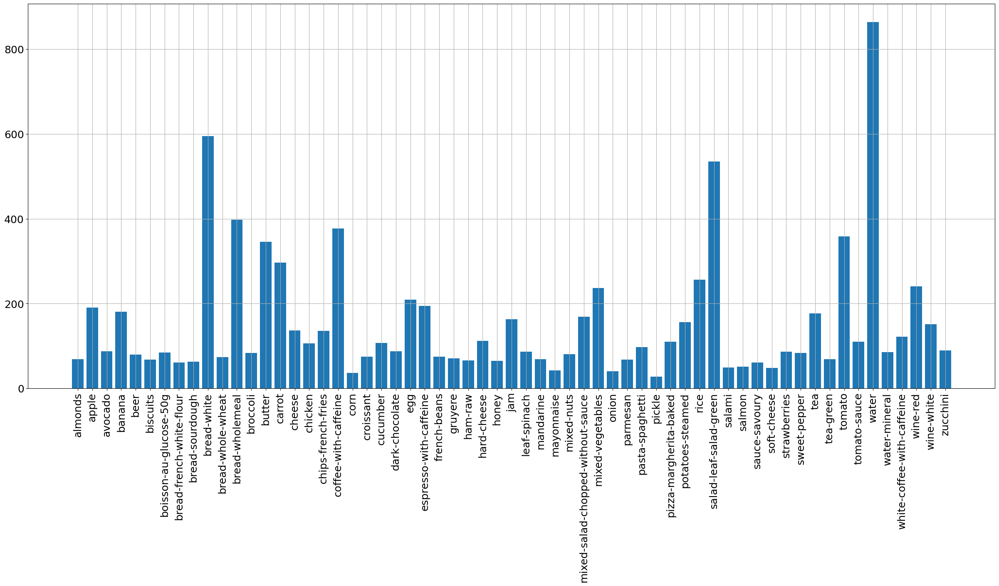

In [10]:
plt.figure(figsize=(30,12))
plt.bar(np.unique(training_dataframe["ClassName"], return_counts=True)[0], np.unique(training_dataframe["ClassName"], return_counts=True)[1])
plt.xticks(rotation=90, fontsize=18)
plt.yticks(fontsize=18)
plt.grid()
plt.show()

In [11]:
training_dataframe.drop_duplicates(subset = ["ClassName"])["ImageId"]

,ImageId
0,f27632d7e5.jpg
1,efa87919ed.jpg
2,4f169e8c8d.jpg
3,a6956654bf.jpg
4,d99ce8c3bf.jpg
...,...
372,11a021fe80.jpg
403,3d14f9187d.jpg
443,244e96cd25.jpg
1053,8a8ff5060a.jpg


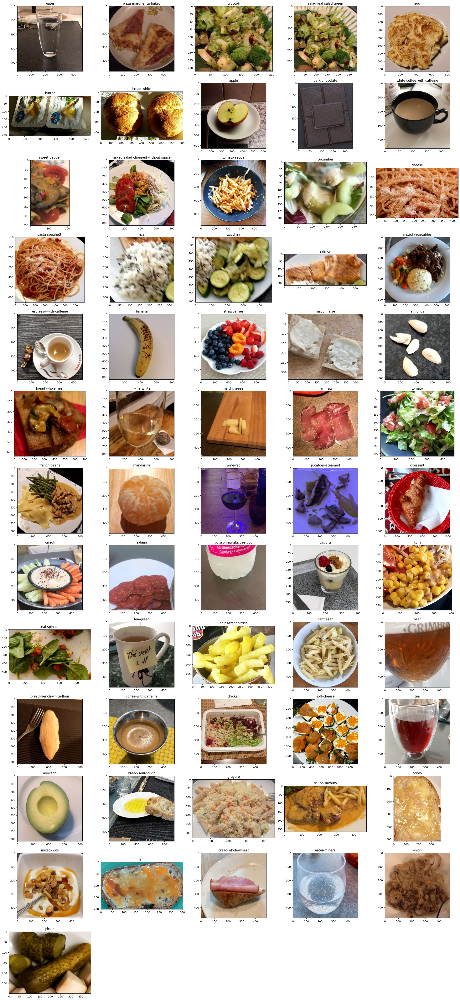

In [12]:
# Mengambil gambar dengan classname yang unik
unique_class_images = np.asarray(training_dataframe.drop_duplicates(subset=["ClassName"])[["ImageId", "ClassName"]])
total_classes = len(unique_class_images)

# Menghitung kolom grid berdasarkan jumlah classname
cols = 5
rows = (total_classes + cols - 1) // cols  # Ceiling division to fit all classes

# Create properly sized grid
fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(24, 4*rows))

# Flatten if multiple rows (consistent indexing)
ax = ax.flatten()

# Track successful loads for title display
loaded_classes = []

# Load images
for i in range(total_classes):
    try:
        img_path = f"{bjoernjostein_food_classification_path}/train_images/train_images/{unique_class_images[i][0]}"
        img = cv2.imread(img_path, cv2.IMREAD_COLOR)
        if img is None:
            raise Exception("Image not loaded")

        ax[i].imshow(img[...,::-1])
        ax[i].set_title(unique_class_images[i][1])  # Show class name
        loaded_classes.append(i)
    except Exception as e:
        print(f"Failed to load image {i}: {e}")

# Hide unused subplots
for i in range(total_classes, len(ax)):
    ax[i].axis('off')
    fig.delaxes(ax[i])

plt.tight_layout()
plt.show()

In [6]:
class_names = pd.get_dummies(training_dataframe["ClassName"]).columns

In [14]:
class_names

Index(['almonds', 'apple', 'avocado', 'banana', 'beer', 'biscuits',
       'boisson-au-glucose-50g', 'bread-french-white-flour', 'bread-sourdough',
       'bread-white', 'bread-whole-wheat', 'bread-wholemeal', 'broccoli',
       'butter', 'carrot', 'cheese', 'chicken', 'chips-french-fries',
       'coffee-with-caffeine', 'corn', 'croissant', 'cucumber',
       'dark-chocolate', 'egg', 'espresso-with-caffeine', 'french-beans',
       'gruyere', 'ham-raw', 'hard-cheese', 'honey', 'jam', 'leaf-spinach',
       'mandarine', 'mayonnaise', 'mixed-nuts',
       'mixed-salad-chopped-without-sauce', 'mixed-vegetables', 'onion',
       'parmesan', 'pasta-spaghetti', 'pickle', 'pizza-margherita-baked',
       'potatoes-steamed', 'rice', 'salad-leaf-salad-green', 'salami',
       'salmon', 'sauce-savoury', 'soft-cheese', 'strawberries',
       'sweet-pepper', 'tea', 'tea-green', 'tomato', 'tomato-sauce', 'water',
       'water-mineral', 'white-coffee-with-caffeine', 'wine-red', 'wine-white',
     

In [7]:
y_dev = np.asarray(pd.get_dummies(training_dataframe["ClassName"]))

In [16]:
y_dev.shape

(9323, 61)

In [8]:
X_dev = np.asarray(training_dataframe["ImageId"])

In [18]:
X_dev.shape

(9323,)

In [9]:
train_path = f"{bjoernjostein_food_classification_path}/train_images/train_images/"

In [10]:
def batch_generator(batch_size, gen_x):
    batch_features = np.zeros((batch_size,256,256,3))
    batch_labels = np.zeros((batch_size,61))
    while True:
        for i in range(batch_size):
            batch_features[i] , batch_labels[i] = next(gen_x)
        yield batch_features, batch_labels

In [11]:
def generate_data(filelist, img_path, target):
    while True:
        for i,j in enumerate(filelist):
            X_train = cv2.imread(img_path + j, cv2.IMREAD_COLOR )
            X_train = cv2.resize(X_train, (256,256), interpolation= cv2.INTER_LINEAR )

            y_train = target[i]

            yield X_train, y_train

In [24]:
def create_model():
    base_model = tf.keras.applications.EfficientNetB1(
    weights= "imagenet", include_top=False, input_shape= (256,256,3)
    )
    num_classes=61

    x = base_model.output
    x = tf.keras.layers.GlobalAveragePooling2D()(x)
    x = tf.keras.layers.Dropout(0.2)(x)
    predictions = tf.keras.layers.Dense(num_classes, activation= 'softmax')(x)
    model = tf.keras.Model(inputs = base_model.input, outputs = predictions)
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), loss="categorical_crossentropy", metrics=['acc'])
    return model

In [2]:
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.1, patience=1, verbose=1, mode='min',
    min_delta=0.0001, cooldown=2, min_lr=0
)

NameError: name 'tf' is not defined

In [24]:
class PlotLosses(tf.keras.callbacks.Callback):
    def on_train_begin(self, logs={}):
        self.i = 0
        self.x = []
        self.losses = []
        self.val_losses = []

        self.fig = plt.figure()

        self.logs = []

    def on_epoch_end(self, epoch, logs={}):

        self.logs.append(logs)
        self.x.append(self.i)
        self.losses.append(logs.get('loss'))
        self.val_losses.append(logs.get('val_loss'))
        self.i += 1

        clear_output(wait=True)
        plt.plot(self.x, self.losses, label="loss")
        plt.plot(self.x, self.val_losses, label="val_loss")
        plt.legend()
        plt.show();

plot_losses = PlotLosses()

In [25]:
batch_size = 64
num_epoch = 10
model = create_model()
history = model.fit(x=batch_generator(batch_size, generate_data(X_dev, train_path, y_dev)), epochs=num_epoch,
                            steps_per_epoch=int(y_dev.shape[0]/batch_size),
                            verbose = 1
                            )

ValueError: Shape mismatch in layer #1 (named stem_conv)for weight stem_conv/kernel. Weight expects shape (3, 3, 1, 32). Received saved weight with shape (3, 3, 3, 32)

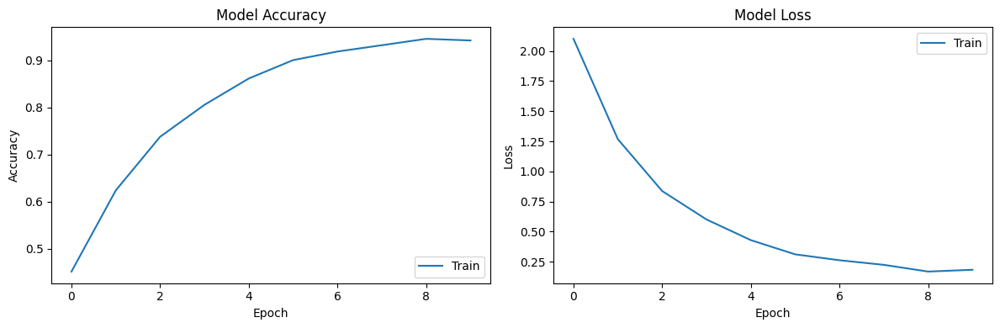

In [26]:
import matplotlib.pyplot as plt

# Plot accuracy
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['acc'])
# plt.plot(history.history['val_acc'])
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='lower right')

# Plot loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
# plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper right')

plt.tight_layout()
plt.savefig('training_history.png', dpi=300)
plt.show()

In [27]:
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling           │ (None, 256, 256,  │          0 │ input_layer[0][0] │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ normalization       │ (None, 256, 256,  │          7 │ rescaling[0][0]   │
│ (Normalization)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_1         │ (None, 256, 256,  │          0 │ normalization[0]… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_conv_pad       │ (None, 257, 257,  │          0 │ rescaling_1[0][0] │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_conv (Conv2D)  │ (None, 128, 128,  │        864 │ stem_conv_pad[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_bn             │ (None, 128, 128,  │        128 │ stem_conv[0][0]   │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_activation     │ (None, 128, 128,  │          0 │ stem_bn[0][0]     │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_dwconv      │ (None, 128, 128,  │        288 │ stem_activation[… │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_bn          │ (None, 128, 128,  │        128 │ block1a_dwconv[0… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_activation  │ (None, 128, 128,  │          0 │ block1a_bn[0][0]  │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_squeeze  │ (None, 32)        │          0 │ block1a_activati… │
│ (GlobalAveragePool… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_reshape  │ (None, 1, 1, 32)  │          0 │ block1a_se_squee… │
│ (Reshape)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_reduce   │ (None, 1, 1, 8)   │        264 │ block1a_se_resha… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_expand   │ (None, 1, 1, 32)  │        288 │ block1a_se_reduc… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_excite   │ (None, 128, 128,  │          0 │ block1a_activati… │
│ (Multiply)          │ 32)               │            │ block1a_se_expan… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_project_co… │ (None, 128, 128,  │        512 │ block1a_se_excit

 Total params: 19,836,032 (75.67 MB)

 Trainable params: 6,591,325 (25.14 MB)

 Non-trainable params: 62,055 (242.41 KB)

 Optimizer params: 13,182,652 (50.29 MB)

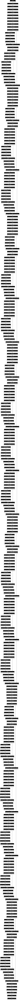

In [28]:
tf.keras.utils.plot_model(model, 'model.png', show_shapes=True)

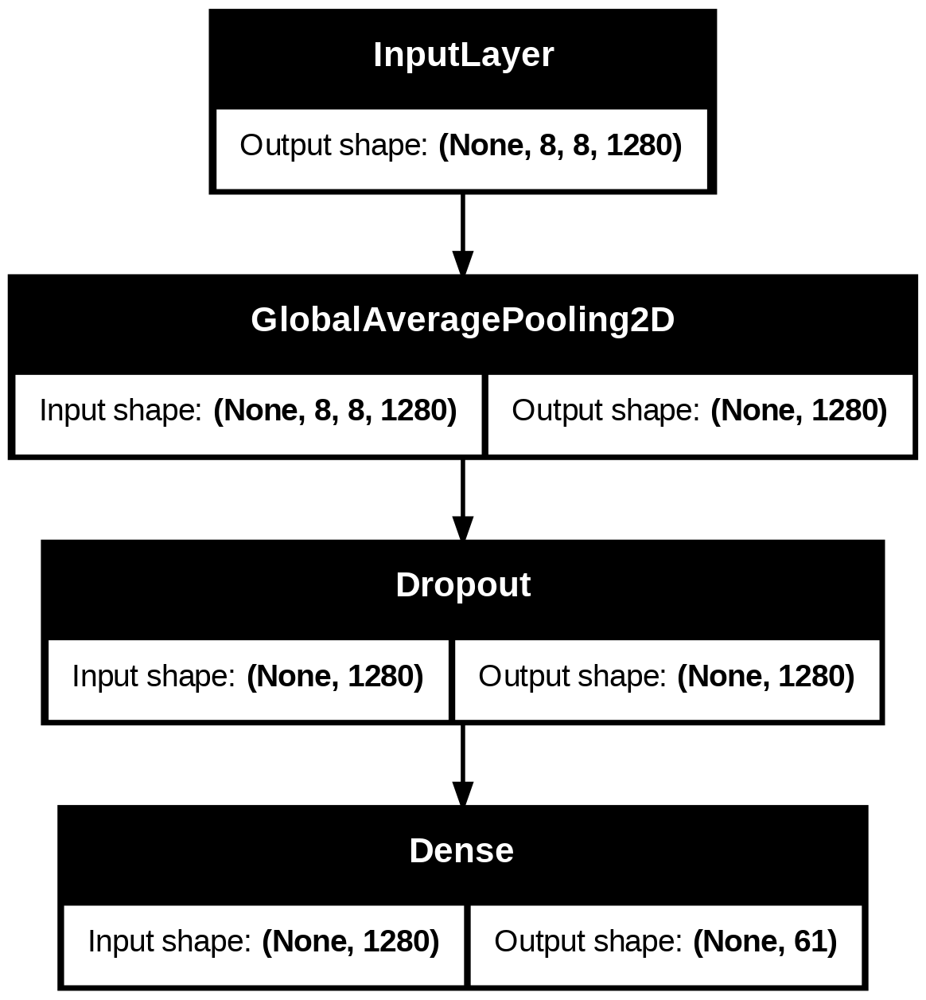

In [29]:
base_model = tf.keras.applications.EfficientNetB1(
weights= "imagenet", include_top=False, input_shape=(256,256,3)
)
head_input = tf.keras.layers.Input(shape=base_model.output_shape[1:])
x = tf.keras.layers.GlobalAveragePooling2D()(head_input)
x = tf.keras.layers.Dropout(0.2)(x)
predictions = tf.keras.layers.Dense(61, activation='softmax')(x)
head_model = tf.keras.Model(inputs=head_input, outputs=predictions)

# Visualize the head model
tf.keras.utils.plot_model(head_model, 'head_model.png', show_shapes=True)

In [30]:
import visualkeras
visualkeras.layered_view(model, to_file='model_viz.png')

/usr/local/lib/python3.12/dist-packages/visualkeras/layered.py:231: UserWarning: The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.
  warnings.warn("The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.")


AttributeError: 'InputLayer' object has no attribute 'output_shape'

In [ ]:
visualkeras.layered_view(head_model, to_file='head_model_viz.png')

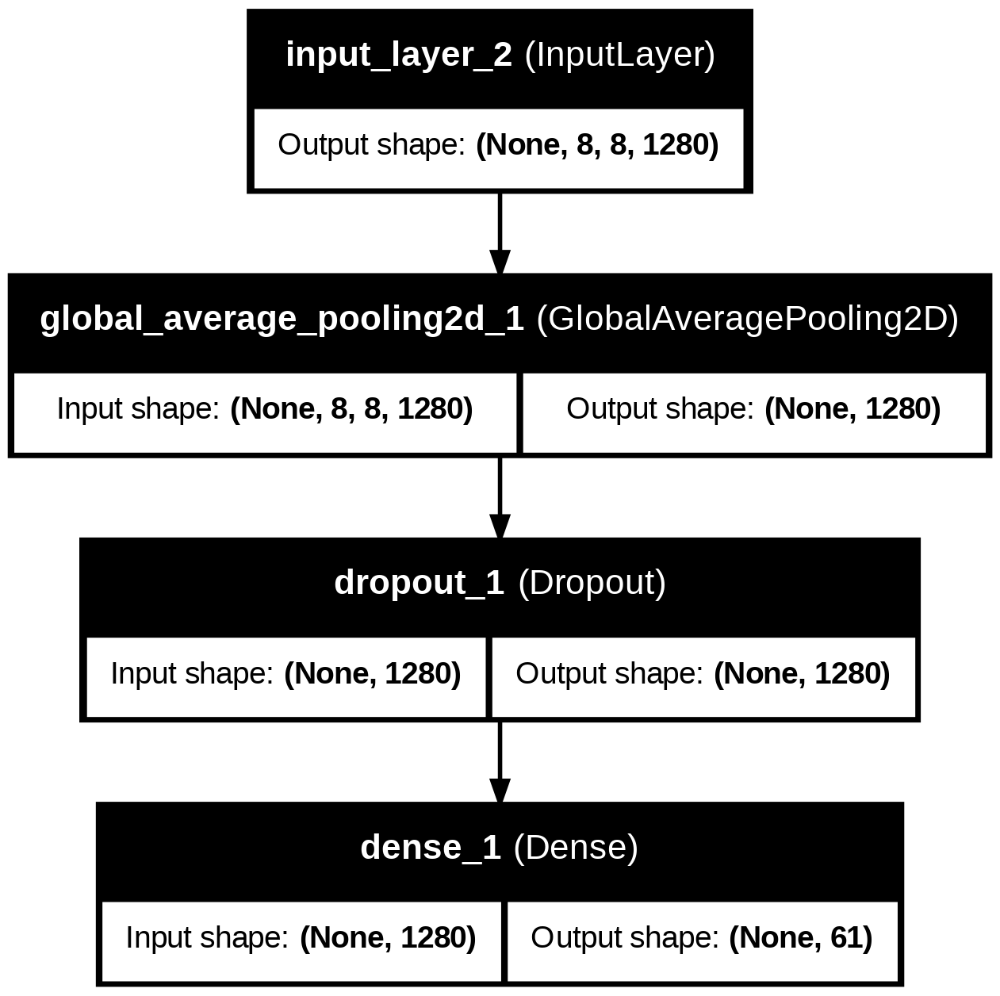

In [31]:
tf.keras.utils.plot_model(
    head_model,
    to_file='head_model_architecture.png',
    show_shapes=True,
    show_layer_names=True
)

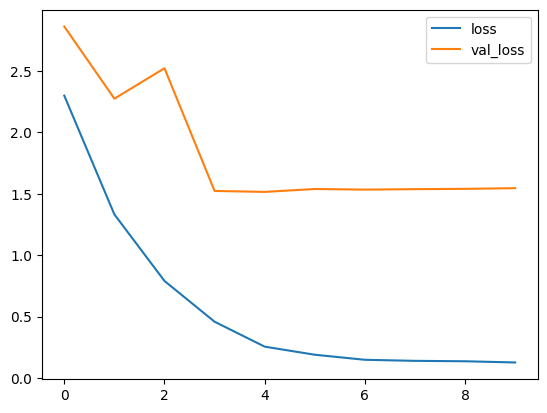


Epoch 10: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.
98/98 ━━━━━━━━━━━━━━━━━━━━ 81s 831ms/step - acc: 0.9733 - loss: 0.1413 - val_acc: 0.5960 - val_loss: 1.5452 - learning_rate: 1.0000e-06
Preprocessing validation images...
Making predictions...
49/49 ━━━━━━━━━━━━━━━━━━━━ 37s 518ms/step


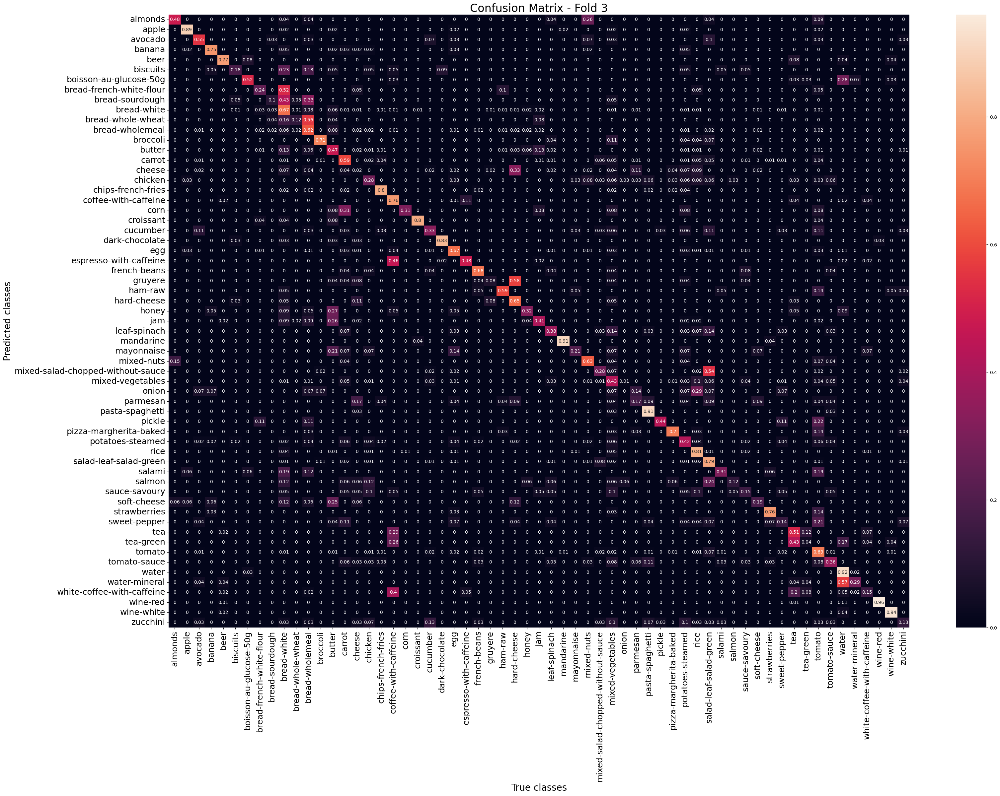

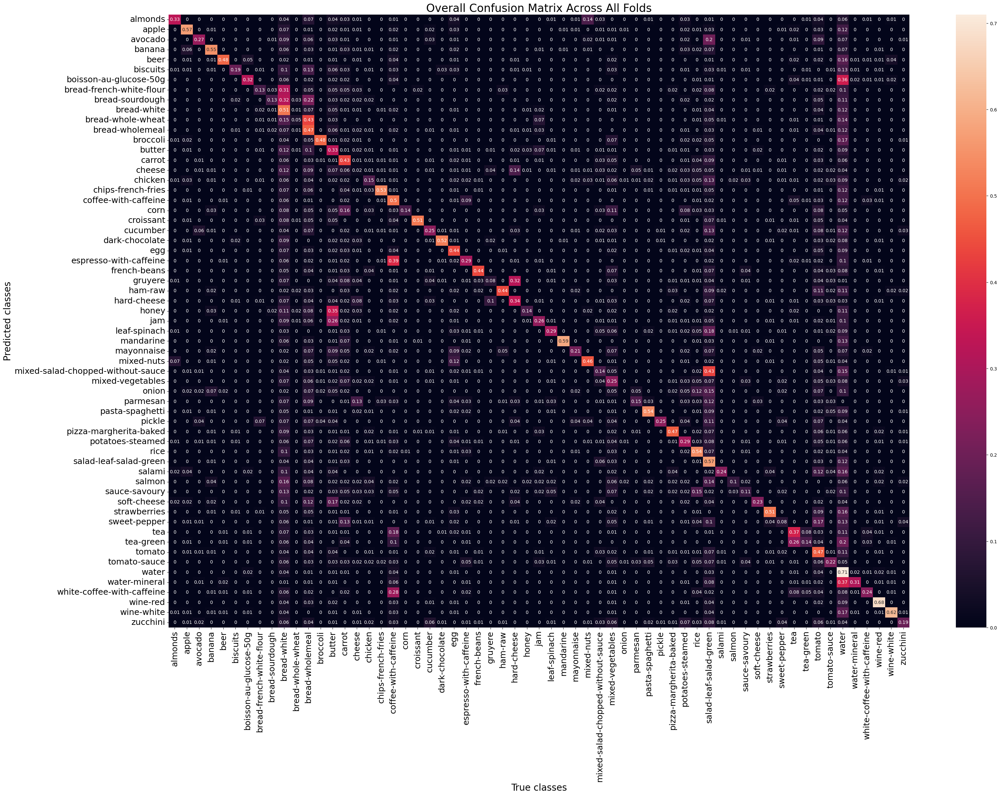

In [32]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

batch_size = 64
num_epoch = 10
skf = StratifiedKFold(n_splits=3)
skf.get_n_splits(X_dev, y_dev)

# Pre-process and cache validation images to avoid repeated disk I/O
def preprocess_images(image_paths, img_dir, target_size=(256, 256)):
    images = []
    for path in image_paths:
        img = cv2.imread(img_dir + path, cv2.IMREAD_COLOR)
        img_rs = cv2.resize(img, target_size, interpolation=cv2.INTER_LINEAR)
        images.append(img_rs)
    return np.array(images)

# Store results for final evaluation
all_true_labels = []
all_pred_labels = []

for fold, (train_index, val_index) in enumerate(skf.split(X_dev, training_dataframe["ClassName"])):
    print(f"Training fold {fold+1}/10...")

    X_train, X_val = X_dev[train_index], X_dev[val_index]
    y_train, y_val = y_dev[train_index], y_dev[val_index]

    # Create and train model
    model = create_model()
    history = model.fit(
        x=batch_generator(batch_size, generate_data(X_train, train_path, y_train)),
        epochs=num_epoch,
        steps_per_epoch=int(np.ceil(y_train.shape[0]/batch_size)),
        validation_data=batch_generator(batch_size, generate_data(X_val, train_path, y_val)),
        validation_steps=int(np.ceil(y_val.shape[0]/batch_size)),
        validation_batch_size=batch_size,
        validation_freq=1,
        verbose=1,
        callbacks=[plot_losses, reduce_lr]
    )

    # Preprocess validation images all at once
    print("Preprocessing validation images...")
    val_images = preprocess_images(X_val, train_path)

    # Make predictions in batches
    print("Making predictions...")
    y_prob = model.predict(
        val_images,
        batch_size=batch_size,
        verbose=1
    )

    # Get predicted and true labels
    true_labels = np.argmax(y_val, axis=1)
    pred_labels = np.argmax(y_prob, axis=1)

    # Store for overall evaluation
    all_true_labels.extend(true_labels)
    all_pred_labels.extend(pred_labels)

    # Create confusion matrix for this fold
    C = confusion_matrix(true_labels, pred_labels)
    C_norm = C / C.astype(float).sum(axis=1, keepdims=True)

    plt.figure(figsize=(36, 24))
    sns.heatmap(np.round(C_norm, 2), annot=True, xticklabels=class_names, yticklabels=class_names)
    plt.xlabel("True classes", fontsize=20)
    plt.ylabel("Predicted classes", fontsize=20)
    plt.xticks(fontsize=18)
    plt.yticks(fontsize=18)
    plt.title(f"Confusion Matrix - Fold {fold+1}", fontsize=24)
    plt.show()

# Overall confusion matrix across all folds
all_true_labels = np.array(all_true_labels)
all_pred_labels = np.array(all_pred_labels)
overall_C = confusion_matrix(all_true_labels, all_pred_labels)
overall_C_norm = overall_C / overall_C.astype(float).sum(axis=1, keepdims=True)

plt.figure(figsize=(36, 24))
sns.heatmap(np.round(overall_C_norm, 2), annot=True, xticklabels=class_names, yticklabels=class_names)
plt.xlabel("True classes", fontsize=20)
plt.ylabel("Predicted classes", fontsize=20)
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
plt.title("Overall Confusion Matrix Across All Folds", fontsize=24)
plt.show()

In [33]:
import lime
from lime import lime_image
import shap
import shap

In [34]:
f_name = []
pred = []
for i in os.listdir(f"{bjoernjostein_food_classification_path}/test_images/test_images/"):
    f_name.append(i)
    img = cv2.imread(f"{bjoernjostein_food_classification_path}/test_images/test_images/" + i, cv2.IMREAD_COLOR )
    img = cv2.resize(img, (256,256), interpolation= cv2.INTER_LINEAR )
    prediction = model.predict(np.expand_dims(img,0))
    pred.append(class_names[np.argmax(prediction)])

1/1 ━━━━━━━━━━━━━━━━━━━━ 13s 13s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━

In [35]:
def f(x):
    tmp = x.copy()
    return model.predict(tmp)

In [36]:
predictions = pred

In [37]:
# Converting the list to dataframe
predictions_df = pd.DataFrame(predictions, columns=["ClassName"])

# Add a filename column with the value f_name
predictions_df['filename'] = f_name

predictions_df

,ClassName,filename
0,chips-french-fries,552884be28.jpg
1,water,90e63a2fde.jpg
2,dark-chocolate,7dc938e2bc.jpg
3,espresso-with-caffeine,486caeaecb.jpg
4,chips-french-fries,7480d78dad.jpg
...,...,...
479,wine-red,7df76c57af.jpg
480,ham-raw,6c2eaa8a44.jpg
481,butter,9c6b28d6b2.jpg
482,tomato,10ff3341e9.jpg


In [42]:
predictions_df.to_csv("pred_result.csv", index=False)

In [1]:
# Save the trained model
model.save('food_classification_model.h5')

NameError: name 'model' is not defined